# Fuzzy-SVM

## Task I
- Fuzzy-SVM implementation

#### Basic imports

In [1]:
from typing import Any, Dict, List, Union, Tuple, Union
import numpy as np
from sklearn.svm import SVC

#### Size count utility

In [2]:
def _get_count(x: Union[np.ndarray, List[Any], Any]):
    if type(x) == list:
        return len(x)
    elif type(x) == np.ndarray:
        return x.shape[0]
    else:
        return 1

### Fuzzy SVM implementation

In [3]:
class FSVM(object):
    def __init__(self, C: float =1.0, kernel: str ='rbf', degree: int =3, 
                 gamma: Union[str, float] ='scale', max_iter: int =-1, 
                 random_state: int =12) -> None:
        super().__init__()
        self.__C = C
        self.__kernel = kernel
        self.__gamma = gamma
        self.__seed = random_state
        self.__svms: Dict[Tuple[Any, Any], SVC] ={}
        self.__classes: List[Any] =[]
        self.__tuples: Dict[Any, List[Tuple[Any, Any]]] ={}
        self.__max_iter = max_iter
        self.__degree = degree
        self._estimator_type = "classifier"
        
    def __memberships_i_j(self, decisions_i_j: np.ndarray) -> np.ndarray:
        return np.where(decisions_i_j >= 1, 1, decisions_i_j)   
    
    def __generate_membership_functions(self, x):
        memberships: np.ndarray =np.zeros((_get_count(x), len(self.__classes)))
        for index, _class in enumerate(self.__classes):
            tups = self.__tuples[_class]
            count = len(tups)
            decisions_arr: np.ndarray =np.zeros((_get_count(x), count))
            for _tup_idx, tup in enumerate(tups):
                __svm_decision: np.ndarray =self.__svms[tup].decision_function(x)
                decisions_arr[:, _tup_idx] = __svm_decision
            __memberships_i: np.ndarray =self.__memberships_i_j(decisions_arr)
            memberships[:, index] = np.min(__memberships_i, axis=1)
        return memberships

    def fit(self, X, Y):
        self.__classes = sorted(list(set(Y)))
        self.__svms = {}
        self.__tuples = {}
        for _class in self.__classes:
            for __class in  self.__classes:
                if _class != __class:
                    if _class not in self.__tuples or len(self.__tuples[_class]) < 1:
                        self.__tuples[_class] = []
                    self.__tuples[_class].append((_class, __class))
                    _x = np.vstack([X[Y == _class], X[Y == __class]]) 
                    _y = np.hstack([Y[Y == _class], Y[Y == __class]])
                    _y = np.where(_y == _class, 1, -1) 
                    self.__svms[(_class, __class)] = SVC(C=self.__C, gamma=self.__gamma,
                                                         max_iter=self.__max_iter,
                                                         kernel=self.__kernel, degree=self.__degree,
                                                         random_state=self.__seed)
                    __svm = self.__svms[(_class, __class)]
                    __svm.fit(_x, _y)
        return self

    @property
    def classes_(self): return self.__classes

    def decision_function(self, X):
        return self.__generate_membership_functions(X)
    
    def predict(self, X):
        memberships = self.__generate_membership_functions(X)
        return np.argmax(memberships, axis=1)

## Task II
- prepare some artificial classifications problems

#### Additional imports

In [4]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs, make_gaussian_quantiles, make_moons, make_classification
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

#### Utilities for normalization and presentation layer of datasets

In [5]:
def display_2D_dataset(X, Y, colors=["green", "orange"], title="", ax=None, rasterized=True):
    if ax is None: fig, ax = plt.subplots()
    unique_Y = list(sorted(set(Y)))
    assert len(colors) == len(unique_Y) and len(X[0]) == 2
    for y, c in zip(unique_Y, colors):
        x = X[Y == y]
        ax.scatter(x[:, 0], x[:, 1], c=[c], alpha=0.6, rasterized=rasterized)
    ax.set_title(title)
    if ax is None: plt.show()
    
def normalize_data_set(train: np.ndarray, test: np.ndarray =None) -> Tuple[np.ndarray, np.ndarray]:
    scaler = MinMaxScaler()
    scaler.fit(train)
    return (scaler.transform(train), scaler.transform(test) if test is not None else None)

### Generate datasets


In [6]:
idx = "239512"

In [7]:
int(str(idx[::3])[::-1])

52

#### Helper class

In [8]:
class Dataset(object):

    def __init__(self, X: np.ndarray, Y: np.ndarray, name: str):
        self.__X = X
        self.__Y = Y
        self.__name = name
    
    @property
    def name(self): return self.__name

    @property
    def X(self): return self.__X

    @property
    def Y(self): return self.__Y

    def set_X(self, X: np.ndarray): 
        assert X.shape == self.__X.shape
        self.__X = X

#### Generation procedure

In [9]:

gauss_X, gauss_Y = make_gaussian_quantiles(n_samples=int(idx)//int(idx[::3][::-1]), n_features=2, n_classes=2, random_state=int(idx), 
                                           mean=[int(idx[2])/int(idx[3]), int(idx[4])/int(idx[3])], cov=int(idx[4])/int(idx[5]))

gauss_3_X, gauss_3_Y = make_gaussian_quantiles(n_samples=int(idx)//int(idx[::3][::-1]), n_features=2, n_classes=3, random_state=int(idx), 
                                              mean=[int(idx[2])/int(idx[3]), int(idx[4])/int(idx[3])], cov=int(idx[4])/int(idx[5]))

moon_X, moon_Y = make_moons(n_samples=int(idx)//int(idx[::3][::-1]), shuffle=True, random_state=int(idx), noise=int(idx[-2:0:-1])/int(idx[2:]))
blobs_X, blobs_Y = make_blobs(n_samples=int(idx)//int(idx[::3][::-1]), n_features=2, centers=2, random_state=int(idx), cluster_std=5)
blobs_3_X, blobs_3_Y = make_blobs(n_samples=int(idx)//int(idx[::3][::-1]), n_features=2, centers=[(-2, 5), (-1.32, 0), (5, -2)], 
                                  random_state=int(idx), cluster_std=[1.1, 2, 1])
class_X, class_Y = make_classification(n_samples=int(idx)//int(idx[::3][::-1]), n_features=2, n_classes=2,
                                       n_clusters_per_class=1, n_informative=1, n_redundant=0, random_state = int(idx))
class_3_X, class_3_Y = make_classification(n_samples=int(idx)//int(idx[::3][::-1]), n_features=2, n_classes=3,
                                       n_clusters_per_class=1, n_informative=2, n_redundant=0, random_state = int(idx))                                    
  
datasets = {2:[
                Dataset(gauss_X, gauss_Y, "make_gaussian"),
                Dataset(moon_X, moon_Y, "make_moons"),
                Dataset(blobs_X, blobs_Y, "make_blobs"),
                Dataset(class_X, class_Y, "make_classification")
            ], 
            3:[
                Dataset(gauss_3_X, gauss_3_Y, "make_gaussian"),
                Dataset(blobs_3_X, blobs_3_Y, "make_blobs"),
                Dataset(class_3_X, class_3_Y, "make_classification")
            ]}   

#### Split datasets for training and test parts

In [10]:
def get_train_test(data: Dataset):
   train_x, test_x, train_y, test_y = train_test_split(data.X, data.Y, stratify=data.Y, test_size=0.25)
   return {"train":Dataset(train_x, train_y, data.name), "test":Dataset(test_x, test_y, data.name)}
for key in datasets.keys():
    datasets[key] = [get_train_test(data) for data in datasets[key]]

#### Normalize datasets

In [11]:
for key in datasets.keys():
    for d in datasets[key]:
        train_x, test_x = normalize_data_set(d["train"].X, d["test"].X)
        d["train"].set_X(train_x)
        d["test"].set_X(test_x)

#### Display train datasets

In [12]:
colors = {2: [
            ["coral", "indigo"],
            ["chartreuse", "slateblue"],
            ["lightsteelblue", "mediumaquamarine"],
            ["khaki", "steelblue"]
          ],
          3: [
            ["coral", "indigo", "springgreen"],
            ["chartreuse", "slateblue", "crimson"],
            ["lightsteelblue", "mediumaquamarine", "bisque"]
          ]}

cmaps = {2: [
            plt.get_cmap('viridis'),
            plt.get_cmap('copper'),
            plt.get_cmap('magma'),
            plt.get_cmap('cividis')

        ],
        3: [
            plt.get_cmap('gnuplot'),
            plt.get_cmap('terrain'),
            plt.get_cmap('ocean')
        ]}

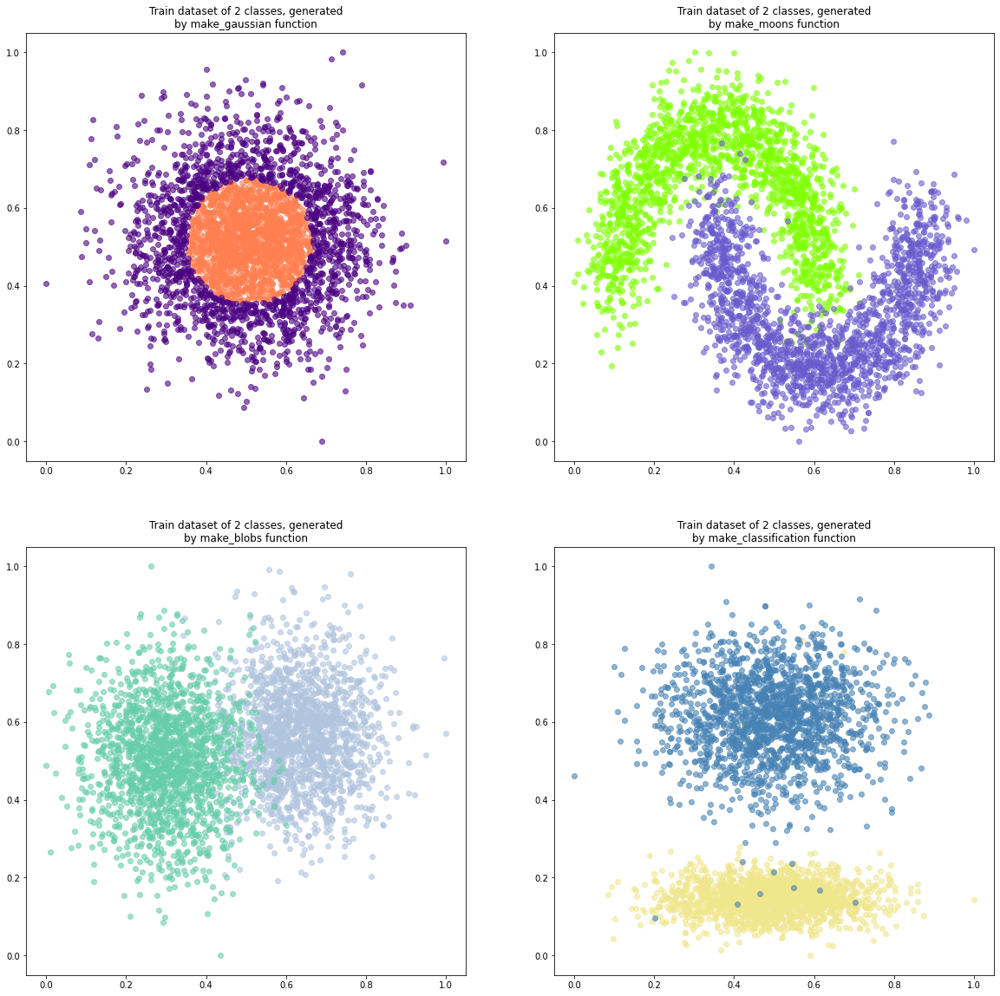

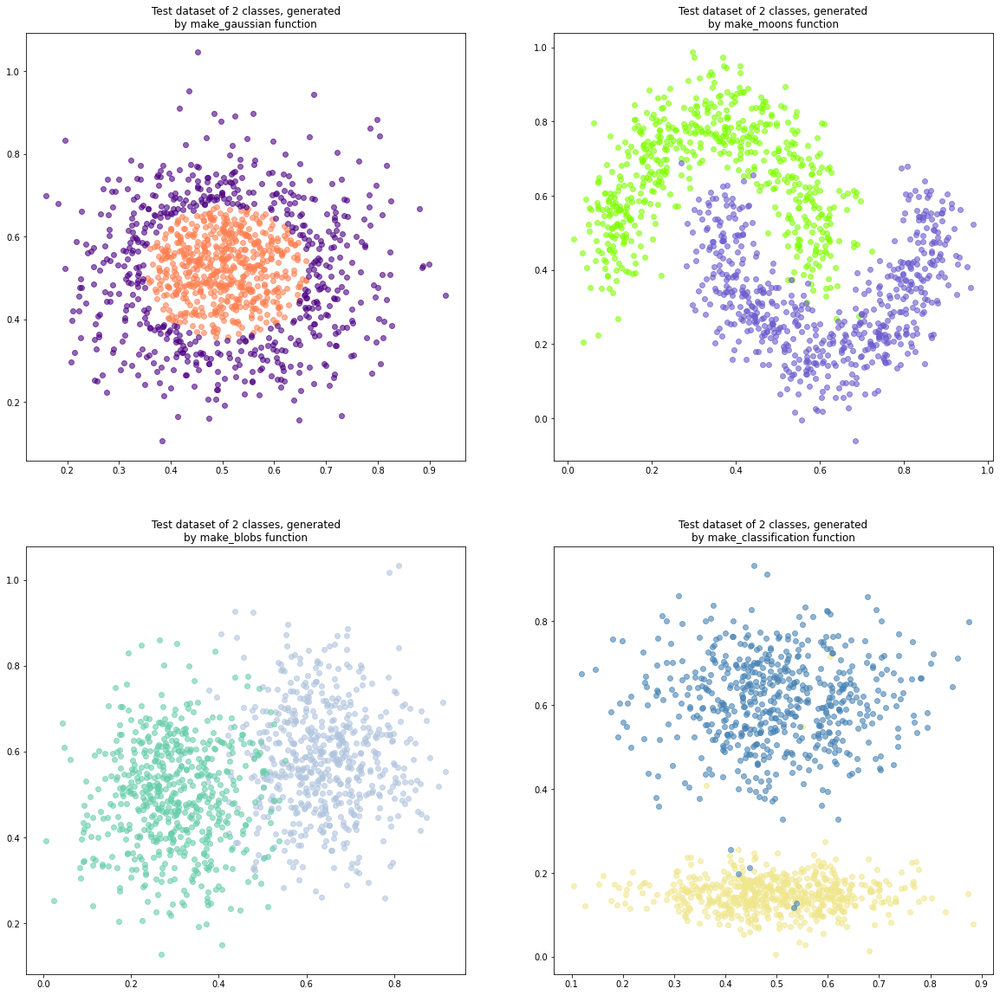

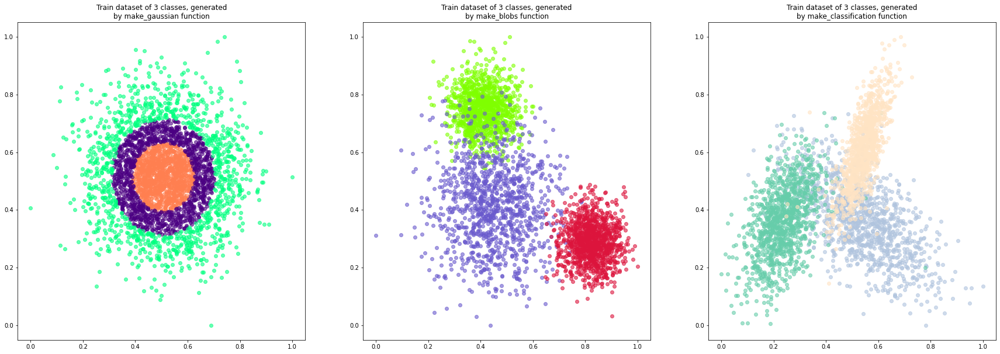

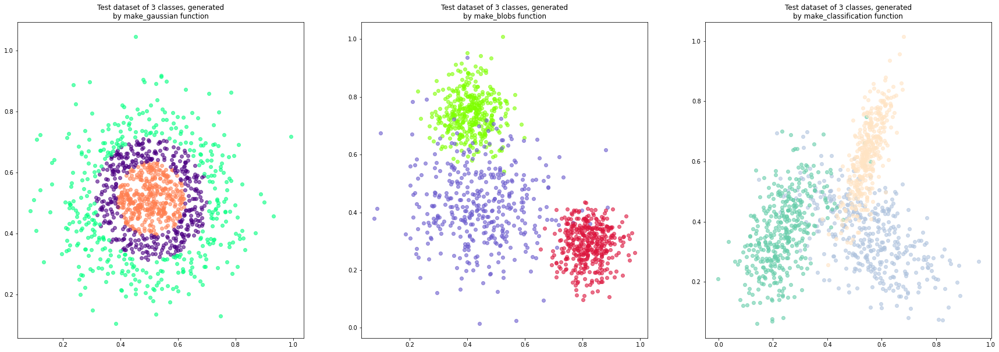

In [13]:
for key in datasets.keys():
    fig, axes = plt.subplots(ncols=(2 if key == 2 else 3), nrows=(2 if key == 2 else 1), figsize=((20,20) if key == 2 else (30, 10)))
    for i, tup in enumerate(zip(datasets[key], axes.flat)):
        data, ax = tup
        display_2D_dataset(data["train"].X, data["train"].Y, colors=colors[key][i], ax=ax,
                           title=f"Train dataset of {key} classes, generated\nby {data['train'].name} function")
    plt.show()
    fig, axes = plt.subplots(ncols=(2 if key == 2 else 3), nrows=(2 if key == 2 else 1), figsize=((20,20) if key == 2 else (30, 10)))
    for i, tup in enumerate(zip(datasets[key], axes.flat)):
        data, ax = tup
        display_2D_dataset(data["test"].X, data["test"].Y, colors=colors[key][i], ax=ax,
                           title=f"Test dataset of {key} classes, generated\nby {data['train'].name} function")
    plt.show()

## Task III
- perform classifications tests

#### Parameters settings for SVM's

In [14]:
svm_params = [
    dict(C=1, gamma='scale', max_iter=1_000_000, kernel='rbf', random_state=int(idx)),
    dict(C=1, gamma='scale', max_iter=1_000_000, kernel='sigmoid', random_state=int(idx)),
    dict(C=1, gamma='scale', max_iter=1_000_000, kernel='poly', degree=3, random_state=int(idx)),
    dict(C=1, gamma='scale', max_iter=1_000_000, kernel='poly', degree=9, random_state=int(idx)),
    dict(C=1, gamma='scale', max_iter=1_000_000, kernel='poly', degree=21, random_state=int(idx)),
    dict(C=1, gamma='scale', max_iter=1_000_000, kernel='linear', random_state=int(idx))
]

keys= {2:[
            "make_gaussian",
            "make_moons",
            "make_blobs",
            "make_classification"
        ], 
        3:[
            "make_gaussian",
            "make_blobs",
            "make_classification"
        ]} 

#### Additional imports

In [15]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix

In [16]:
from sklearn.utils._testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning

#### Classify and store results


In [17]:
results_2 = {}
results_3 = {} 
with ignore_warnings(category=ConvergenceWarning):
    for params in svm_params:
        for data in datasets[2]:
            svm = SVC(**params)
            fsvm = FSVM(**params)
            train, test = data["train"], data["test"]
            svm.fit(train.X, train.Y)
            svm_pred = svm.predict(test.X)
            fsvm.fit(train.X, train.Y)
            fsvm_pred = fsvm.predict(test.X)
            r = {"fsvm":{
                     "clf":fsvm,
                     "acc":accuracy_score(test.Y, fsvm_pred),
                     "f1":f1_score(test.Y, fsvm_pred),
                     "conf":confusion_matrix(test.Y, fsvm_pred)
                 }, 
                 "svm":{
                     "clf":svm,
                     "acc":accuracy_score(test.Y, svm_pred),
                     "f1":f1_score(test.Y, svm_pred),
                     "conf":confusion_matrix(test.Y, svm_pred)
                 },
                 "test":test} 
    
            results_2[(train.name, tuple(sorted(params.items())))] = r
        for data in datasets[3]:
            svm = SVC(**params)
            fsvm = FSVM(**params)
            train, test = data["train"], data["test"]
            svm.fit(train.X, train.Y)
            svm_pred = svm.predict(test.X)
            fsvm.fit(train.X, train.Y)
            fsvm_pred = fsvm.predict(test.X)
            r = {"fsvm":{
                     "clf":fsvm,
                     "acc":accuracy_score(test.Y, fsvm_pred),
                     "f1":f1_score(test.Y, fsvm_pred, average="weighted"),
                     "conf":confusion_matrix(test.Y, fsvm_pred)
                 }, 
                 "svm":{
                     "clf":svm,
                     "acc":accuracy_score(test.Y, svm_pred),
                     "f1":f1_score(test.Y, svm_pred, average="weighted"),
                     "conf":confusion_matrix(test.Y, svm_pred)
                 },
                 "test":test} 
    
            results_3[(train.name, tuple(sorted(params.items())))] = r

#### Additional imports

In [18]:
from matplotlib.patches import Patch
from matplotlib.colors import ListedColormap
from sklearn.metrics import ConfusionMatrixDisplay

#### Results' display procedures and functions

In [19]:
def make_meshgrid(x, y, h=.02):
    x_min, x_max = x.min() - 1, x.max() + 1
    y_min, y_max = y.min() - 1, y.max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.pcolormesh(xx, yy, Z, **params)
    ax.contour(xx, yy, Z, colors="black", alpha=params['alpha'], antialiased=True, linewidths=0.4)

def plot_classification_boundaries(title, clf, X, Y, colors, y_label="", x_label="", ax=None, alpha=0.5, fontsize=35, size_of_point=15, rasterized=True):
    if ax is None: fig, ax = plt.subplots()

    X0, X1 = X[:, 0], X[:, 1]
    xx, yy = make_meshgrid(X0, X1)
    targets = list(sorted(set(Y)))
    plot_contours(ax, clf, xx, yy, cmap=ListedColormap(colors), alpha=0.5, shading='auto', rasterized=rasterized)

    for cl, color in zip(targets, colors):
        x0 = X0[Y == cl]
        x1 = X1[Y == cl]
        ax.scatter(x0, x1, c=[color],  s=size_of_point, edgecolors='k', zorder=911, linewidths=0.2)

    ax.set_ylabel(y_label)
    ax.set_xlabel(x_label)
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_xlim(-0.05, xx.max()/2)
    ax.set_ylim(-0.05, yy.max()/2)
    ax.set_title(title, fontsize=fontsize)
    ax.legend([
            Patch(facecolor=c) for c in colors
        ], [f"Class: {i}" for i in range(len(colors))], loc='upper left', bbox_to_anchor=(1,1,1,0))
    if ax is None: plt.show()

#### Results for 1st 2-class dataset

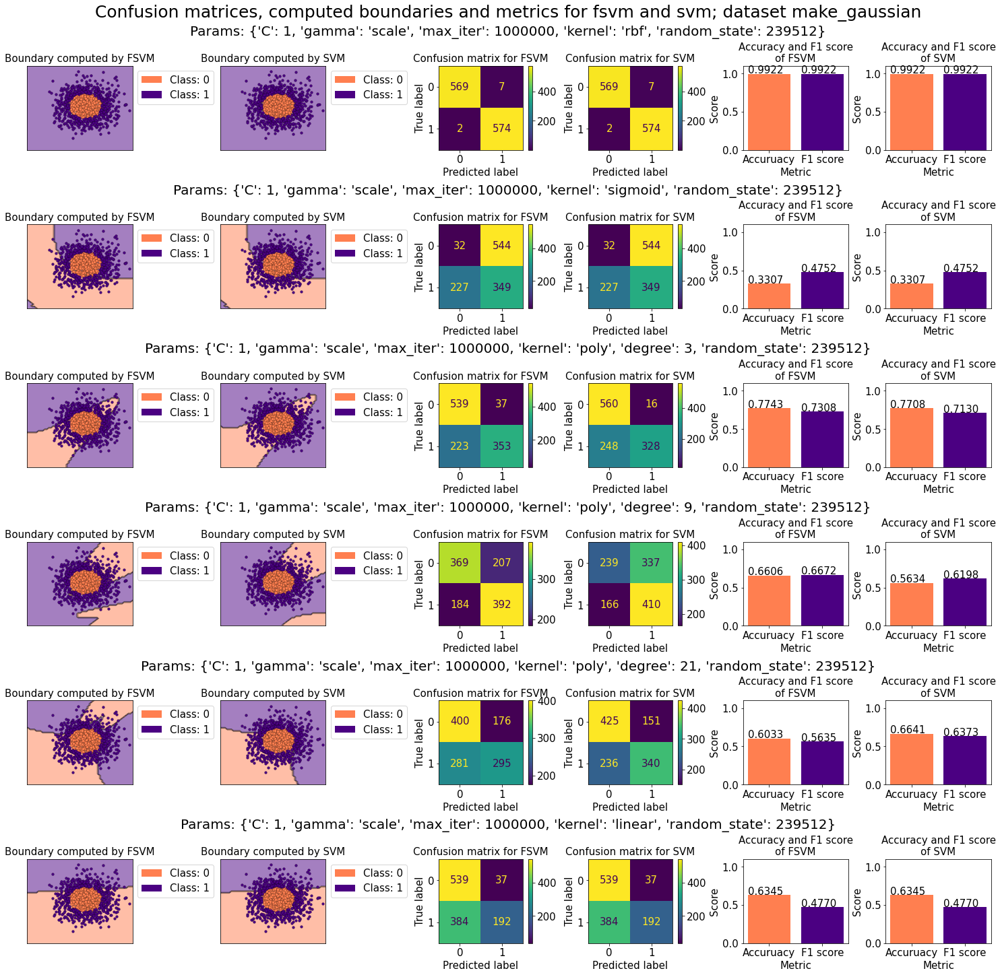

In [20]:
color_list = colors[2][0]
cmap = cmaps[2][0]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[2][0]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_2[(keys[2][0], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

#### Results for 2nd 2-class dataset

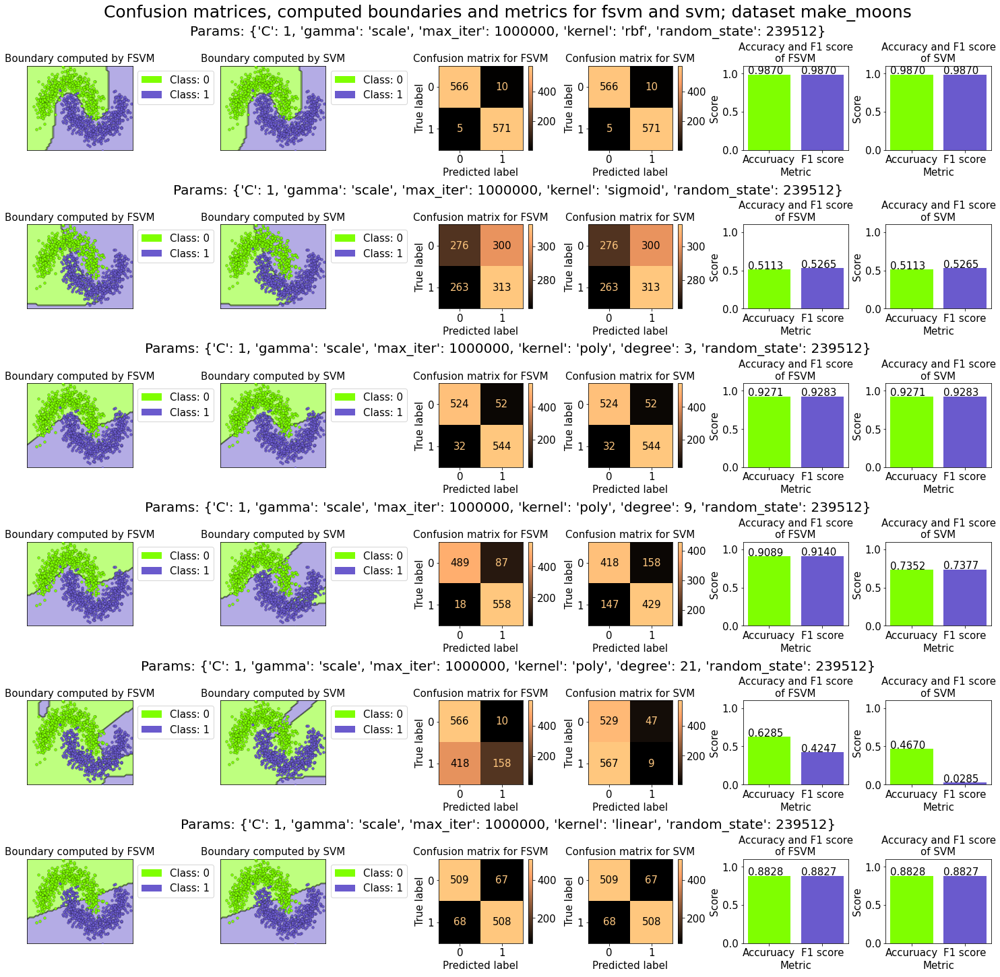

In [21]:
color_list = colors[2][1]
cmap = cmaps[2][1]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[2][1]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_2[(keys[2][1], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

#### Results for 3rd 2-class dataset

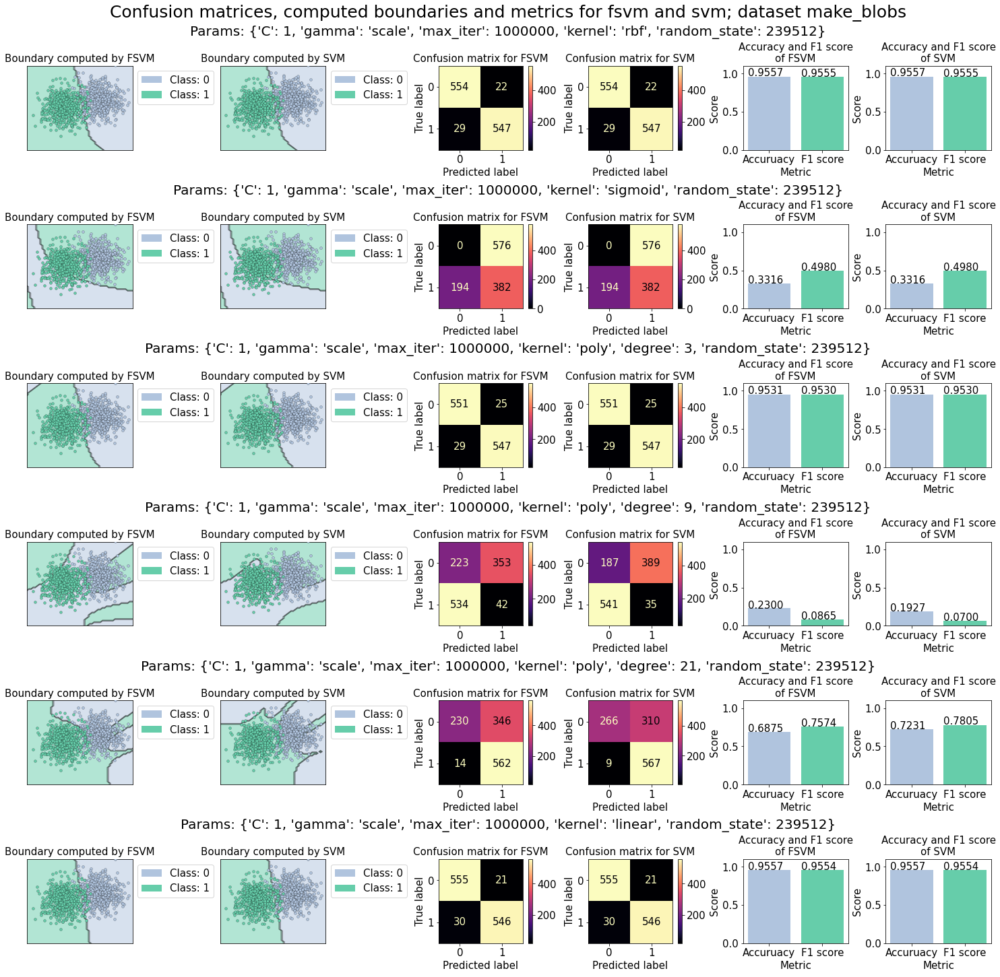

In [22]:
color_list = colors[2][2]
cmap = cmaps[2][2]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[2][2]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_2[(keys[2][2], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

#### Results for 4th 2-class dataset

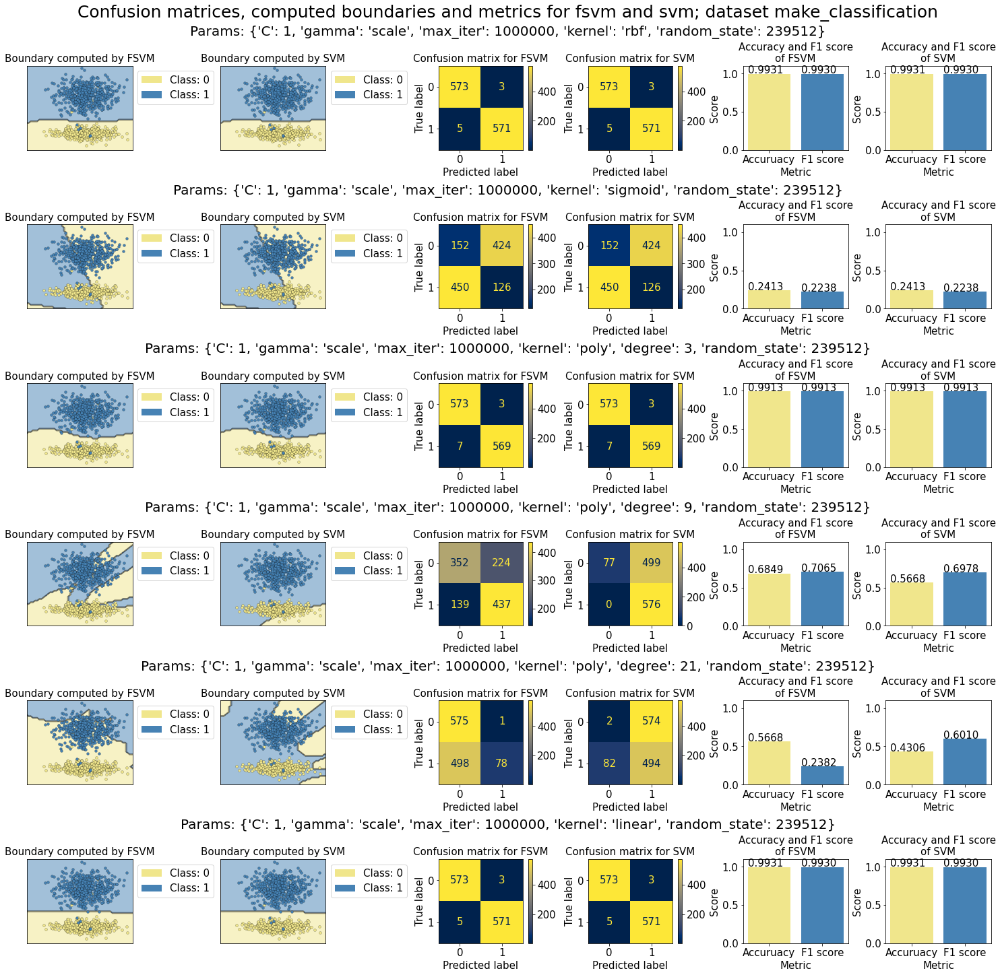

In [23]:
color_list = colors[2][3]
cmap = cmaps[2][3]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[2][3]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_2[(keys[2][3], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

#### Results for 1st 3-class dataset

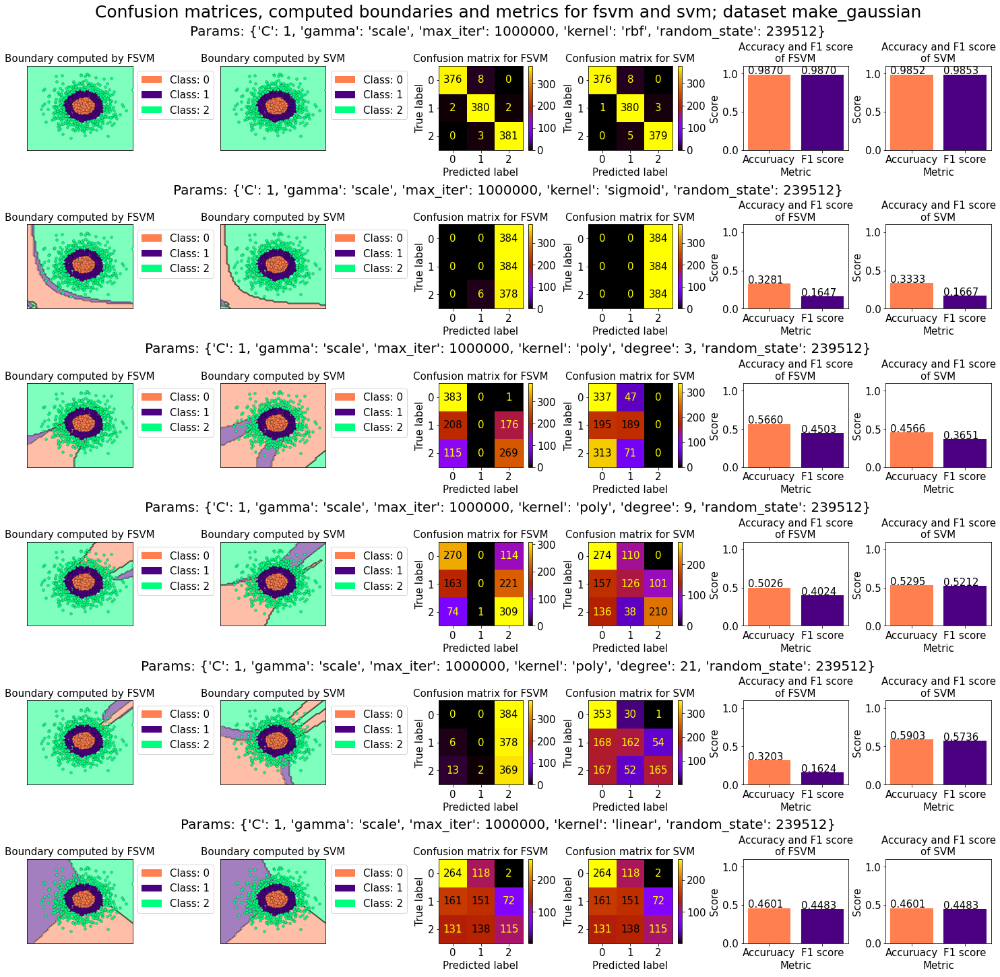

In [24]:
color_list = colors[3][0]
cmap = cmaps[3][0]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[3][0]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_3[(keys[3][0], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

#### Results for 2nd 3-class dataset

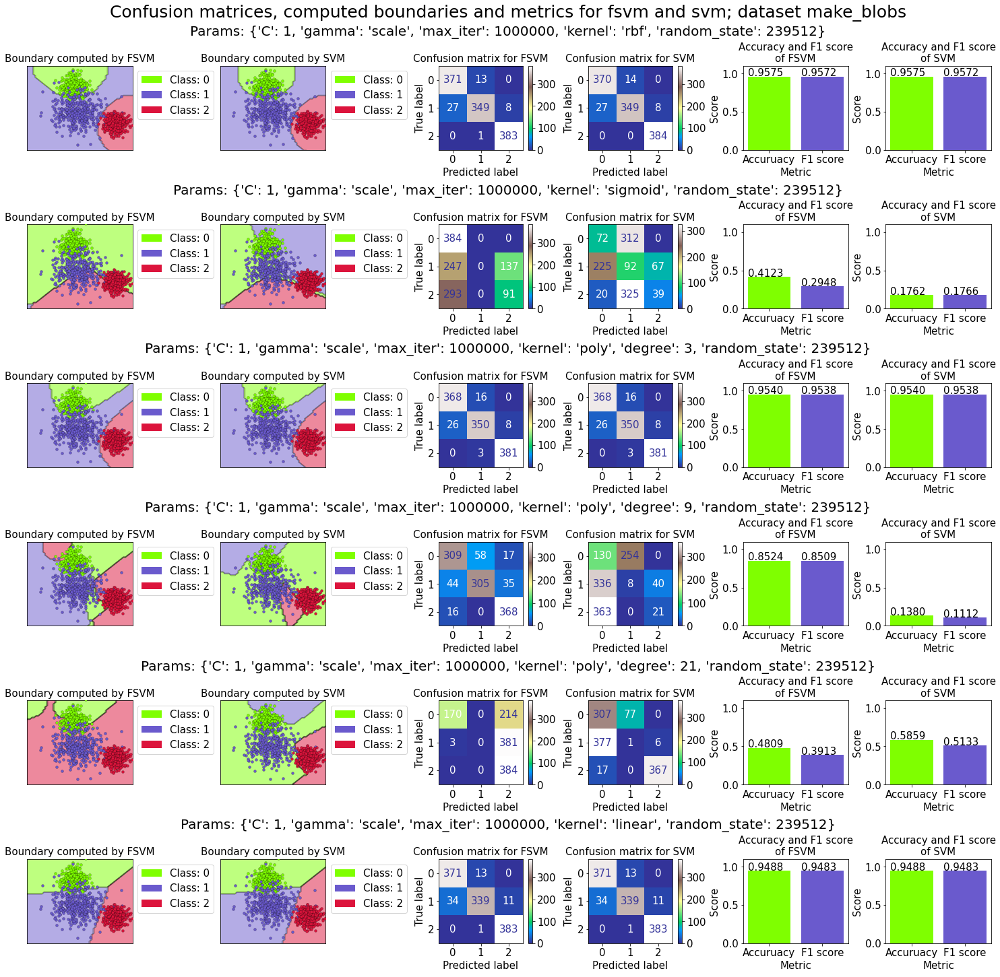

In [25]:
color_list = colors[3][1]
cmap = cmaps[3][1]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[3][1]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_3[(keys[3][1], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

#### Results for 3rd 3-class dataset

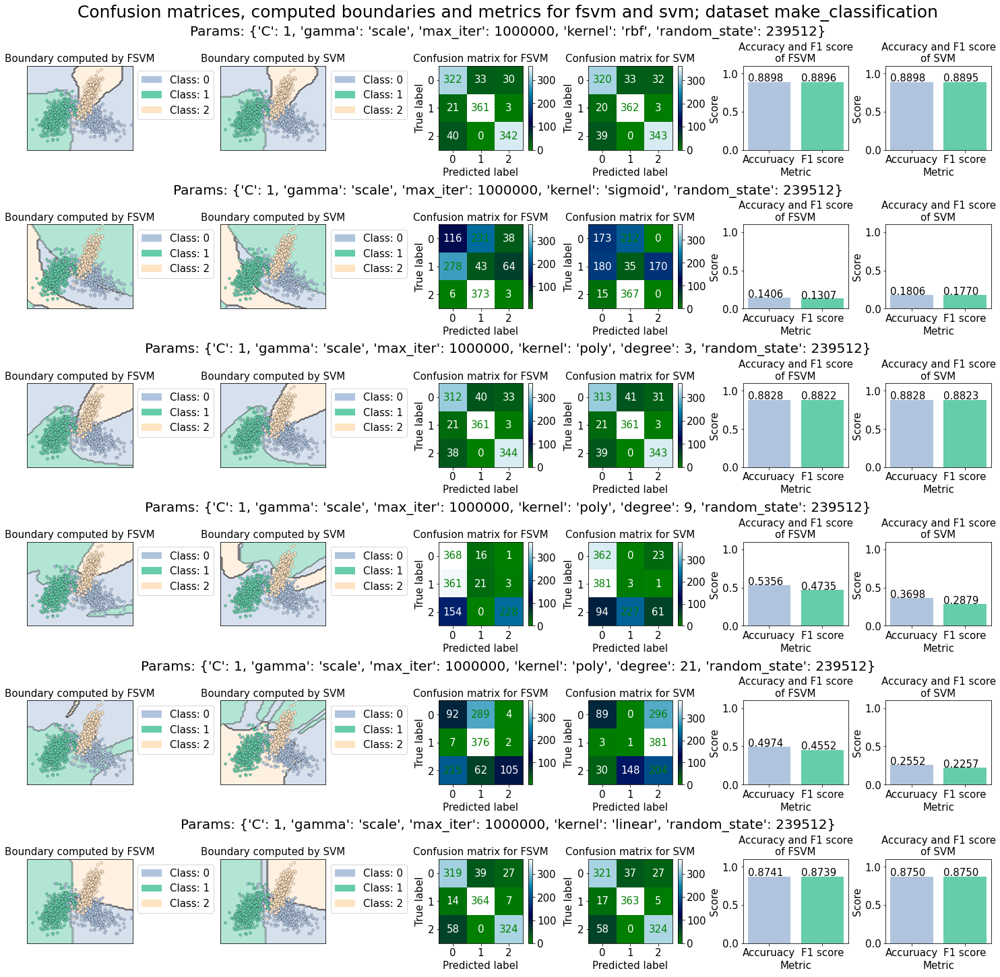

In [26]:
color_list = colors[3][2]
cmap = cmaps[3][2]
fig = plt.figure(constrained_layout=True, figsize=(20, 20))
fig.suptitle(f'Confusion matrices, computed boundaries and metrics for fsvm and svm; dataset {keys[3][2]}', fontsize=25)

subfigs = fig.subfigures(nrows=6, ncols=1)
plt.rcParams.update({'font.size': 15})
for i, tup in enumerate(zip(subfigs, svm_params)):
    subfig, params = tup
    subfig.suptitle(f'Params: {params}', fontsize=20)

    axes = subfig.subplots(nrows=1, ncols=6)

    results = results_3[(keys[3][2], tuple(sorted(params.items())))]
    fsvm, svm, test = results['fsvm'], results['svm'], results['test']
    
    plot_classification_boundaries("Boundary computed by FSVM", 
                                                fsvm['clf'], test.X, test.Y, color_list, ax=axes[0], fontsize=15)
    plot_classification_boundaries("Boundary computed by SVM",
                                                svm['clf'], test.X, test.Y, color_list, ax=axes[1], fontsize=15)

    fsvm_fig = ConfusionMatrixDisplay(fsvm['conf'], display_labels=list(set(test.Y)))
    svm_fig = ConfusionMatrixDisplay(svm['conf'], display_labels=list(set(test.Y)))
    fsvm_fig.plot(ax=axes[2], cmap=cmap)
    svm_fig.plot(ax=axes[3], cmap=cmap)
    axes[2].set_title("Confusion matrix for FSVM", fontsize=15)
    axes[3].set_title("Confusion matrix for SVM", fontsize=15)

    rects_f = axes[4].bar(np.arange(0, 2, 1), [fsvm['acc'], fsvm['f1']],  tick_label= ['Accuruacy', 'F1 score'], color=color_list)
    axes[4].set_title("Accuracy and F1 score\nof FSVM", fontsize=15)
    axes[4].set_xlabel("Metric")
    axes[4].set_ylabel("Score")
    axes[4].set_ylim(0, 1.1)
    rects_s = axes[5].bar(np.arange(0, 2, 1), [svm['acc'], svm['f1']], tick_label=['Accuruacy', 'F1 score'], color=color_list)
    axes[5].set_title("Accuracy and F1 score\nof SVM", fontsize=15)
    axes[5].set_xlabel("Metric")
    axes[5].set_ylabel("Score")
    axes[5].set_ylim(0, 1.1)
    for ax in (axes[4], axes[5]):
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)
plt.show()

## Real-world example of classification

#### Dataset description:
- Attributes: 
    1. Mean of the integrated profile.
    2. Standard deviation of the integrated profile.
    3. Excess kurtosis of the integrated profile.
    4. Skewness of the integrated profile.
    5. Mean of the DM-SNR curve.
    6. Standard deviation of the DM-SNR curve.
    7. Excess kurtosis of the DM-SNR curve.
    8. Skewness of the DM-SNR curve.
    9. Class

In [27]:
import urllib.request, zipfile, io, pandas as pd
header = ["Mean of the integrated profile", "Standard deviation of the integrated profile","Excess kurtosis of the integrated profile",
"Skewness of the integrated profile","Mean of the DM-SNR curve", "Standard deviation of the DM-SNR curve","Excess kurtosis of the DM-SNR curve",
"Skewness of the DM-SNR curve", "Class"]
url = "https://archive.ics.uci.edu/ml/machine-learning-databases/00372/HTRU2.zip"
name = "HTRU_2.csv"
with urllib.request.urlopen(url) as _file:
    z = zipfile.ZipFile(io.BytesIO(_file.read()))
    f = z.open(name)
    table = pd.read_csv(f, delimiter=',', names=header )
table

,Mean of the integrated profile,Standard deviation of the integrated profile,Excess kurtosis of the integrated profile,Skewness of the integrated profile,Mean of the DM-SNR curve,Standard deviation of the DM-SNR curve,Excess kurtosis of the DM-SNR curve,Skewness of the DM-SNR curve,Class
0,140.562500,55.683782,-0.234571,-0.699648,3.199833,19.110426,7.975532,74.242225,0
1,102.507812,58.882430,0.465318,-0.515088,1.677258,14.860146,10.576487,127.393580,0
2,103.015625,39.341649,0.323328,1.051164,3.121237,21.744669,7.735822,63.171909,0
3,136.750000,57.178449,-0.068415,-0.636238,3.642977,20.959280,6.896499,53.593661,0
4,88.726562,40.672225,0.600866,1.123492,1.178930,11.468720,14.269573,252.567306,0
...,...,...,...,...,...,...,...,...,...
17893,136.429688,59.847421,-0.187846,-0.738123,1.296823,12.166062,15.450260,285.931022,0
17894,122.554688,49.485605,0.127978,0.323061,16.409699,44.626893,2.945244,8.297092,0
17895,119.335938,59.935939,0.159363,-0.743025,21.430602,58.872000,2.499517,4.595173,0
17896,114.507812,53.902400,0.201161,-0.024789,1.946488,13.381731,10.007967,134.238910,0


In [28]:
train, test = train_test_split(table, stratify=table.Class, random_state=239512, test_size=0.2)
train

,Mean of the integrated profile,Standard deviation of the integrated profile,Excess kurtosis of the integrated profile,Skewness of the integrated profile,Mean of the DM-SNR curve,Standard deviation of the DM-SNR curve,Excess kurtosis of the DM-SNR curve,Skewness of the DM-SNR curve,Class
15210,92.117188,48.602762,0.583279,0.357874,1.560201,17.490147,11.716992,141.568832,0
5525,142.554688,56.754792,-0.263939,-0.873393,52.304348,81.789370,1.039535,-0.717235,0
16258,91.210938,36.213700,0.426461,2.443080,0.847826,10.696337,16.360979,318.429721,0
17734,102.726562,50.696202,0.450554,-0.051022,2.019231,14.545700,10.517916,132.917259,0
11222,110.820312,37.467368,0.211653,1.138414,5.412207,25.915475,5.686697,35.832485,0
...,...,...,...,...,...,...,...,...,...
2448,124.570312,56.349590,0.103723,-0.561383,17.150502,49.035521,2.847956,7.093757,0
7773,113.648438,48.444490,0.287555,0.468926,5.285953,27.863562,5.633567,32.555527,0
6801,132.484375,43.230303,0.043148,0.513480,4.278428,21.477496,6.482718,49.706546,0
3470,112.007812,43.635295,0.214345,0.350373,3.323579,18.276348,7.107208,61.272996,0


In [29]:
test

,Mean of the integrated profile,Standard deviation of the integrated profile,Excess kurtosis of the integrated profile,Skewness of the integrated profile,Mean of the DM-SNR curve,Standard deviation of the DM-SNR curve,Excess kurtosis of the DM-SNR curve,Skewness of the DM-SNR curve,Class
8009,132.398438,48.296179,-0.147035,0.022784,1.826923,18.680315,10.733251,116.800143,0
3744,89.796875,41.239461,0.691221,1.253321,5.403846,27.191381,5.795925,36.518680,0
8545,131.445312,50.274995,0.194028,-0.297258,1.498328,12.968479,12.124664,183.295974,0
3377,100.609375,47.755928,0.402585,0.527538,2.064381,15.318416,10.852763,139.321217,0
5509,101.742188,44.636946,0.310742,0.591603,2.793478,18.113863,8.842717,89.845664,0
...,...,...,...,...,...,...,...,...,...
8299,88.953125,39.228071,1.282052,3.199935,98.509197,90.325280,-0.022611,-1.771499,0
13862,129.609375,45.212905,0.594097,0.752459,101.464047,98.480069,0.143041,-1.750200,0
1917,93.390625,35.522931,0.596736,2.643346,5.326087,26.745625,6.102823,40.562242,0
2881,126.515625,46.619970,0.077809,0.399820,1.412207,12.277783,12.606403,198.848191,0


In [30]:
train.iloc[:, :-1], test.iloc[:, :-1] = normalize_data_set(train[header[:-1]], test[header[:-1]])
train

d:\Projects\SI\Lab6\lab6_env\lib\site-packages\pandas\core\indexing.py:1835: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value[:, i].tolist(), pi)


,Mean of the integrated profile,Standard deviation of the integrated profile,Excess kurtosis of the integrated profile,Skewness of the integrated profile,Mean of the DM-SNR curve,Standard deviation of the DM-SNR curve,Excess kurtosis of the DM-SNR curve,Skewness of the DM-SNR curve,Class
15210,0.467499,0.321828,0.236685,0.030619,0.006035,0.098881,0.394284,0.120317,0
5525,0.740711,0.432009,0.150301,0.013000,0.233405,0.727158,0.110905,0.001046,0
16258,0.462590,0.154379,0.220696,0.060457,0.002844,0.032498,0.517535,0.268570,0
17734,0.524968,0.350122,0.223152,0.024768,0.008092,0.070111,0.362460,0.113065,0
11222,0.568811,0.171323,0.198793,0.041788,0.023295,0.181206,0.234240,0.031684,0
...,...,...,...,...,...,...,...,...,...
2448,0.643292,0.426532,0.187788,0.017465,0.075891,0.407115,0.158900,0.007593,0
7773,0.584130,0.319688,0.206532,0.032208,0.022729,0.200241,0.232830,0.028937,0
6801,0.686162,0.249214,0.181612,0.032846,0.018215,0.137842,0.255367,0.043314,0
3470,0.575243,0.254688,0.199068,0.030512,0.013937,0.106563,0.271941,0.053009,0


In [31]:
test

,Mean of the integrated profile,Standard deviation of the integrated profile,Excess kurtosis of the integrated profile,Skewness of the integrated profile,Mean of the DM-SNR curve,Standard deviation of the DM-SNR curve,Excess kurtosis of the DM-SNR curve,Skewness of the DM-SNR curve,Class
8009,0.685696,0.317684,0.162221,0.025824,0.007231,0.110510,0.368175,0.099555,0
3744,0.454930,0.222306,0.247691,0.043432,0.023258,0.193673,0.237139,0.032259,0
8545,0.680533,0.344429,0.196996,0.021244,0.005758,0.054699,0.405103,0.155294,0
3377,0.513500,0.310382,0.218261,0.033047,0.008295,0.077661,0.371347,0.118433,0
5509,0.519636,0.268226,0.208897,0.033964,0.011561,0.104976,0.318001,0.076960,0
...,...,...,...,...,...,...,...,...,...
8299,0.450360,0.195121,0.307934,0.071288,0.440436,0.810563,0.082716,0.000162,0
13862,0.670588,0.276011,0.237788,0.036265,0.453676,0.890245,0.087112,0.000180,0
1917,0.474397,0.145043,0.238057,0.063323,0.022909,0.189318,0.245284,0.035648,0
2881,0.653830,0.295028,0.185146,0.031219,0.005372,0.047950,0.417889,0.168331,0


In [32]:
from sklearn.metrics import roc_curve, auc, plot_roc_curve

In [33]:
pulsars_params = [
    {'C': 5, 'degree': 3, 'gamma': 5, 'kernel': 'poly', 'max_iter': 1000000},
    {'C': 5, 'kernel': 'linear', 'max_iter': 1000000},
    {'C': 1000, 'gamma': 'scale', 'kernel': 'rbf', 'max_iter': 1000000},
]

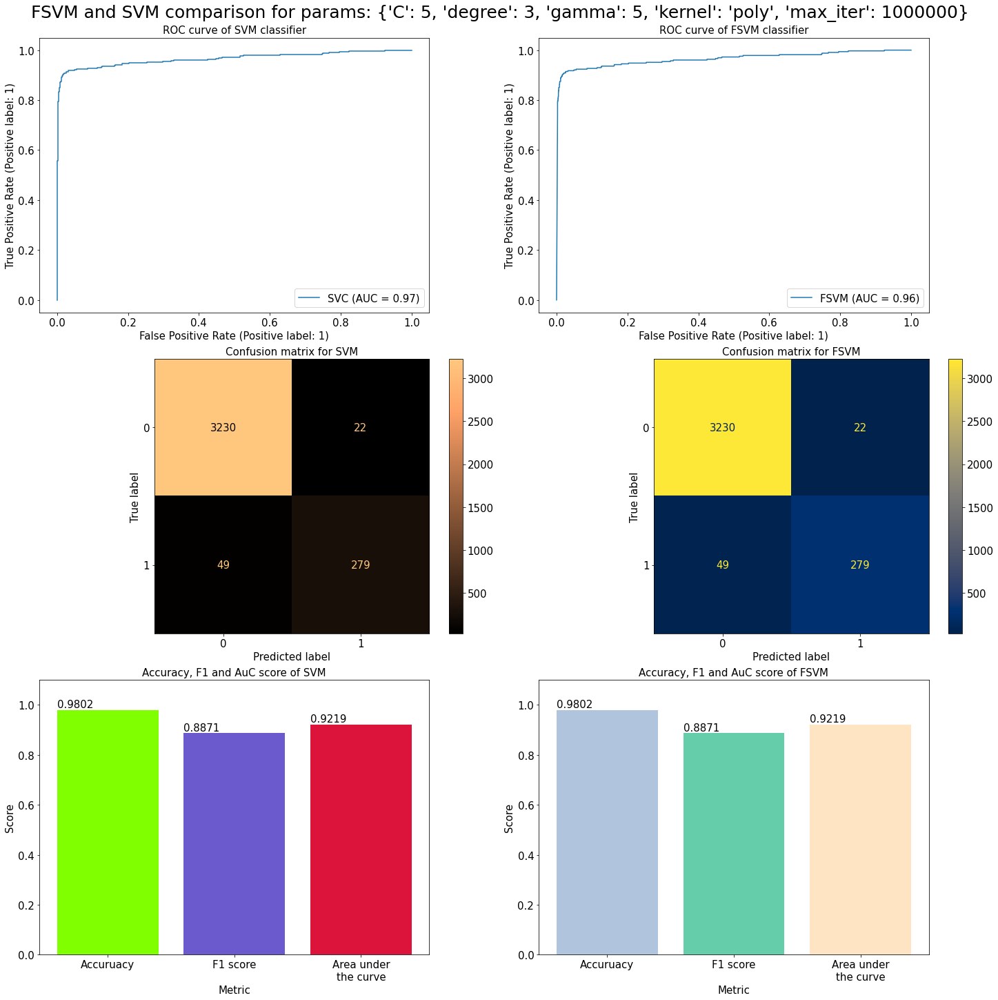

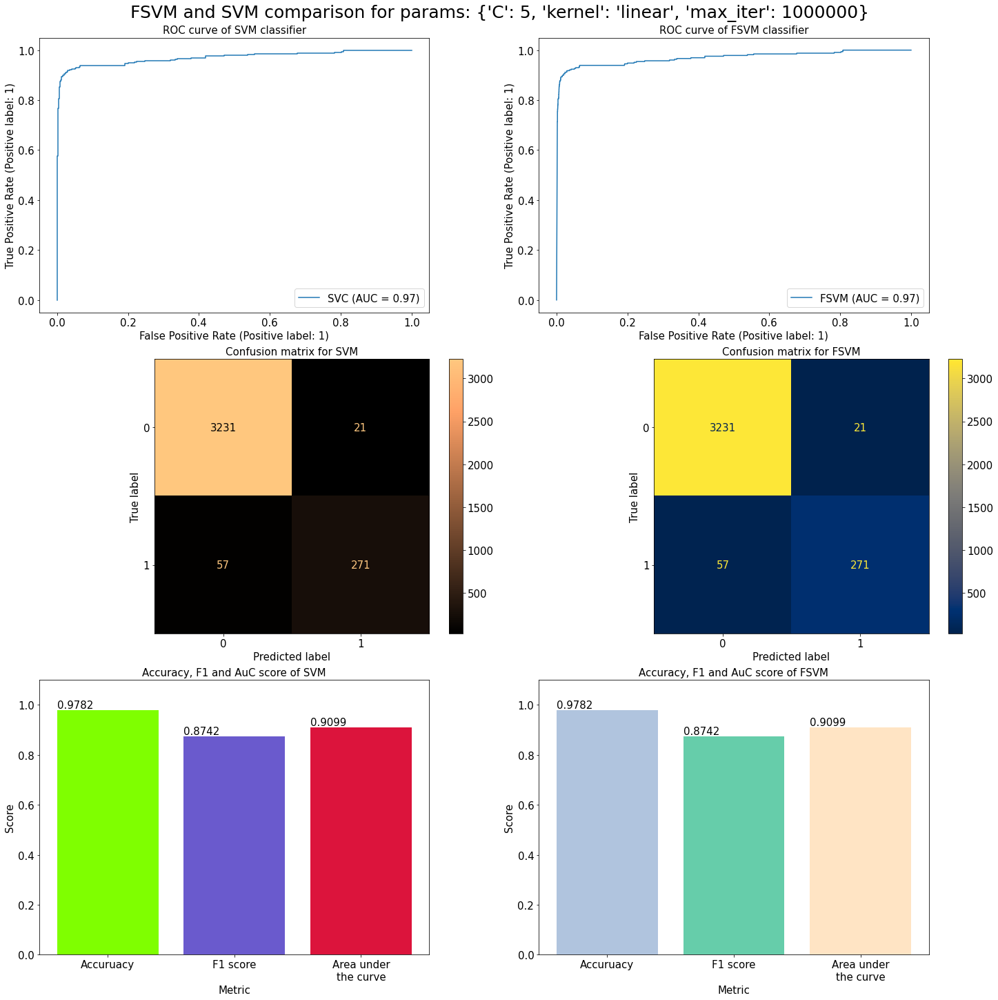

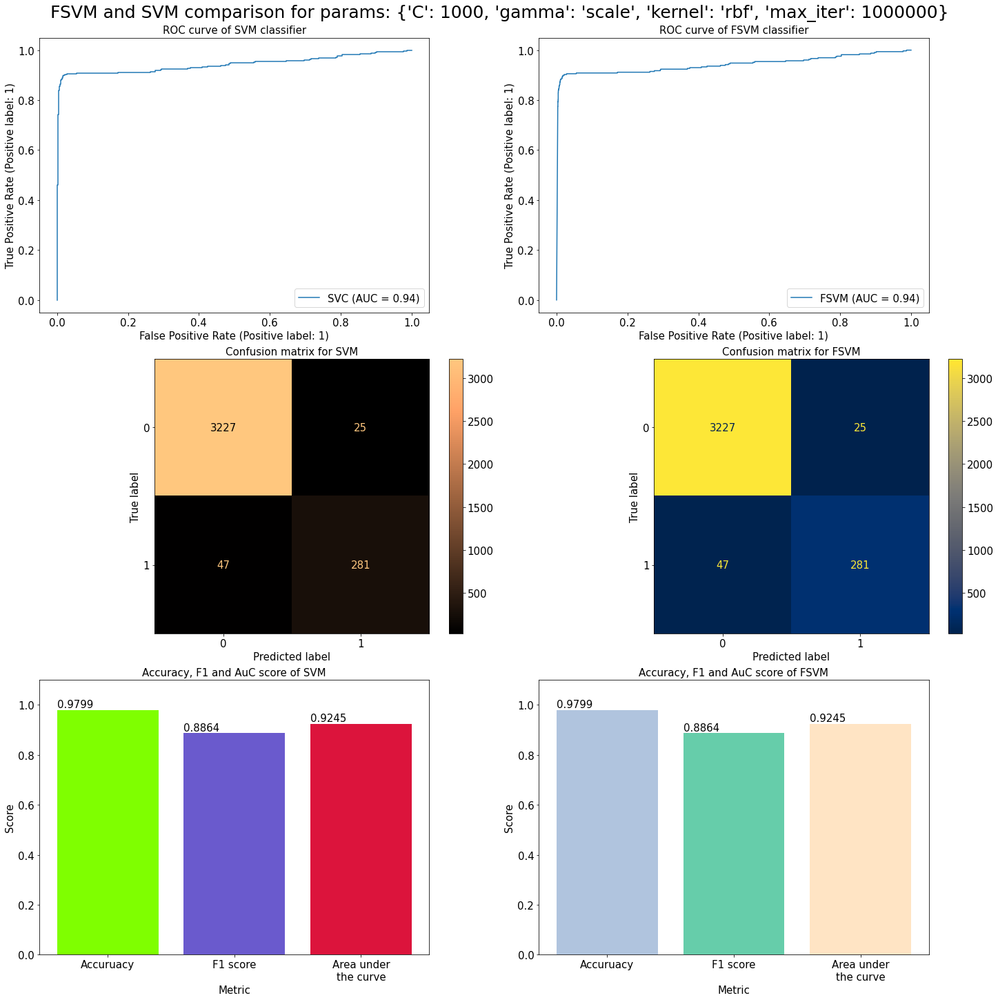

In [34]:
for params in pulsars_params:
    fig, axes = plt.subplots(constrained_layout=True, nrows=3, ncols=2, figsize=(20,20))
    plt.rcParams.update({'font.size': 15})
    svm = SVC(**params)
    fsvm = FSVM(**params)
    fig.suptitle(f"FSVM and SVM comparison for params: {params}", fontsize=25)
    
    svm.fit(train[header[:-1]], train.Class)      
    fsvm.fit(train[header[:-1]].to_numpy(copy=True), train.Class.to_numpy(copy=True))      

    plot_roc_curve(svm, test[header[:-1]], test.Class, ax=axes[0, 0])
    axes[0, 0].set_title("ROC curve of SVM classifier", fontsize=15)
    plot_roc_curve(fsvm, test[header[:-1]].to_numpy(), test.Class.to_numpy(), ax=axes[0, 1])
    axes[0, 1].set_title("ROC curve of FSVM classifier", fontsize=15)

    svm_pred = svm.predict(test[header[:-1]])
    fsvm_pred = fsvm.predict(test[header[:-1]].to_numpy())

    s_conf_mat = confusion_matrix(test.Class, svm_pred, labels=[0,1])
    s_figure = ConfusionMatrixDisplay(s_conf_mat, display_labels=[0,1])
    s_figure.plot(ax=axes[1, 0], cmap=plt.get_cmap('copper'))
    axes[1, 0].set_title(f"Confusion matrix for SVM", fontsize=15)

    f_conf_mat = confusion_matrix(test.Class.to_numpy(), fsvm_pred, labels=[0,1])
    f_figure = ConfusionMatrixDisplay(f_conf_mat, display_labels=[0,1])
    f_figure.plot(ax=axes[1, 1], cmap=plt.get_cmap('cividis'))
    axes[1, 1].set_title(f"Confusion matrix for FSVM", fontsize=15)

    false_positives_s, true_positives_s, _ = roc_curve(test.Class, svm_pred)
    false_positives_f, true_positives_f, _ = roc_curve(test.Class.to_numpy(), fsvm_pred)

    s_acc, s_f1, s_auc = (accuracy_score(test.Class, svm_pred), 
                          f1_score(test.Class, svm_pred), 
                          auc(false_positives_s, true_positives_s))
    f_acc, f_f1, f_auc = (accuracy_score(test.Class.to_numpy(), fsvm_pred), 
                          f1_score(test.Class.to_numpy(), fsvm_pred), 
                          auc(false_positives_f, true_positives_f))

    rects_f = axes[2, 0].bar(np.arange(0, 3, 1), [s_acc, s_f1, s_auc],  tick_label= ['Accuruacy', 'F1 score', 'Area under\nthe curve'], 
                             color=["chartreuse", "slateblue", "crimson"])
    axes[2, 0].set_title("Accuracy, F1 and AuC score of SVM", fontsize=15)
    axes[2, 0].set_xlabel("Metric")
    axes[2, 0].set_ylabel("Score")
    axes[2, 0].set_ylim(0, 1.1)
            
    rects_s = axes[2, 1].bar(np.arange(0, 3, 1), [f_acc, f_f1, f_auc], tick_label=['Accuruacy', 'F1 score', 'Area under\nthe curve'], 
                          color=["lightsteelblue", "mediumaquamarine", "bisque"])
    axes[2, 1].set_title("Accuracy, F1 and AuC score of FSVM", fontsize=15)
    axes[2, 1].set_xlabel("Metric")
    axes[2, 1].set_ylabel("Score")
    axes[2, 1].set_ylim(0, 1.1)
    for ax in axes[2]:
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)

    plt.show()


#### Conclusions
- for pulsars' classification there is no difference between obtained results of FSVM and SVM classification, there are many reasons of this.
    - Pulsars dataset is very simple classification problem, and classes are quite good separated in feature space
    - RBF kernel 3rd degree Polynomial kernel outputs usually accurate results for simple problems
    

## Real problem II - Heart diseases dataset

#### Notes about traits/attributes, according to provided documentation, the number is corresponding to column index in dataframe 
(assuming starting from 1), the type is determined according to documentation 

1. age: age in years; type=(integer, continuous)
2. sex: sex; type=(integer, binary); values=(1 = male; 0 = female)
3. cp: chest pain type; type=(integer, categorical); values={1: typical angina, 2: atypical angina, 3: non-anginal pain, 4: asymptomatic}
4. trestbps: resting blood pressure (in mm Hg on admission to the hospital); type=(float, continuous)
5. chol: serum cholestoral in mg/dl; type=(float, continuous)
6. fbs: (fasting blood sugar > 120 mg/dl); type=(integer, binary); values={1 = true; 0 = false}
7. restecg: resting electrocardiographic results; type=(integer, categorical); values={0: normal, 1: having ST-T wave abnormality (T wave inversions and/or ST elevation or depression of > 0.05 mV), 2: showing probable or definite left ventricular hypertrophy by Estes' criteria}
8. thalach: maximum heart rate achieved; type=(float, continuous) 
9. exang: exercise induced angina; type=(integer, binary); values=(1 = yes; 0 = no)
10. oldpeak = ST depression induced by exercise relative to rest; type=(float, continuous)
11. slope: the slope of the peak exercise ST segment; type=(integer, categorical); values={1: upsloping, 2: flat, 3: downsloping}
12. ca: number of major vessels colored by flourosopy; type=(integer, categorical); values={0,1,2,3} 
13. thal: Thallium stress test indicator; type=(integer, categorical); values={3 = normal; 6 = fixed defect; 7 = reversable defect}
14. class_diagnosis (originally: 'num'): diagnosis of heart disease (angiographic disease status); type=(integer, binary); values={0: Negative, 1,2,3,4: Positive}

In [89]:
url = "https://archive.ics.uci.edu/ml/machine-learning-databases/heart-disease/processed.cleveland.data"
header=["age","sex","cp","trestbps","chol","fbs","restecg","thalach","exang","oldpeak","slope","ca","thal","class_diagnosis"]
heart_df = pd.read_csv(url, delimiter=",", names=header)
heart_df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,class_diagnosis
0,63.0,1.0,1.0,145.0,233.0,1.0,2.0,150.0,0.0,2.3,3.0,0.0,6.0,0
1,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2
2,67.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,7.0,1
3,37.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,3.0,0
4,41.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,3.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,45.0,1.0,1.0,110.0,264.0,0.0,0.0,132.0,0.0,1.2,2.0,0.0,7.0,1
299,68.0,1.0,4.0,144.0,193.0,1.0,0.0,141.0,0.0,3.4,2.0,2.0,7.0,2
300,57.0,1.0,4.0,130.0,131.0,0.0,0.0,115.0,1.0,1.2,2.0,1.0,7.0,3
301,57.0,0.0,2.0,130.0,236.0,0.0,2.0,174.0,0.0,0.0,2.0,1.0,3.0,1


#### Change '?' into NaNs

In [90]:
heart_df = heart_df.replace('?', np.nan)
heart_df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,class_diagnosis
0,63.0,1.0,1.0,145.0,233.0,1.0,2.0,150.0,0.0,2.3,3.0,0.0,6.0,0
1,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2
2,67.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,7.0,1
3,37.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,3.0,0
4,41.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,3.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,45.0,1.0,1.0,110.0,264.0,0.0,0.0,132.0,0.0,1.2,2.0,0.0,7.0,1
299,68.0,1.0,4.0,144.0,193.0,1.0,0.0,141.0,0.0,3.4,2.0,2.0,7.0,2
300,57.0,1.0,4.0,130.0,131.0,0.0,0.0,115.0,1.0,1.2,2.0,1.0,7.0,3
301,57.0,0.0,2.0,130.0,236.0,0.0,2.0,174.0,0.0,0.0,2.0,1.0,3.0,1


#### Remove rows with missing values

In [91]:
heart_df = heart_df.dropna().reset_index(drop=True)
print(heart_df.isna().sum())
print()
heart_df = heart_df.apply(lambda x: x.apply(lambda _x: float(_x)))
heart_df

age                0
sex                0
cp                 0
trestbps           0
chol               0
fbs                0
restecg            0
thalach            0
exang              0
oldpeak            0
slope              0
ca                 0
thal               0
class_diagnosis    0
dtype: int64



,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,class_diagnosis
0,63.0,1.0,1.0,145.0,233.0,1.0,2.0,150.0,0.0,2.3,3.0,0.0,6.0,0.0
1,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2.0
2,67.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,7.0,1.0
3,37.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,3.0,0.0
4,41.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,3.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,57.0,0.0,4.0,140.0,241.0,0.0,0.0,123.0,1.0,0.2,2.0,0.0,7.0,1.0
293,45.0,1.0,1.0,110.0,264.0,0.0,0.0,132.0,0.0,1.2,2.0,0.0,7.0,1.0
294,68.0,1.0,4.0,144.0,193.0,1.0,0.0,141.0,0.0,3.4,2.0,2.0,7.0,2.0
295,57.0,1.0,4.0,130.0,131.0,0.0,0.0,115.0,1.0,1.2,2.0,1.0,7.0,3.0


In [92]:
heart_df, test = train_test_split(heart_df, test_size=0.20, stratify=heart_df["class_diagnosis"])
heart_df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,class_diagnosis
186,54.0,1.0,2.0,192.0,283.0,0.0,2.0,195.0,0.0,0.0,1.0,1.0,7.0,1.0
60,51.0,0.0,4.0,130.0,305.0,0.0,0.0,142.0,1.0,1.2,2.0,0.0,7.0,2.0
84,52.0,1.0,2.0,120.0,325.0,0.0,0.0,172.0,0.0,0.2,1.0,0.0,3.0,0.0
32,64.0,1.0,3.0,140.0,335.0,0.0,0.0,158.0,0.0,0.0,1.0,0.0,3.0,1.0
1,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178,48.0,1.0,4.0,124.0,274.0,0.0,2.0,166.0,0.0,0.5,2.0,0.0,7.0,3.0
289,63.0,0.0,4.0,124.0,197.0,0.0,0.0,136.0,1.0,0.0,2.0,0.0,3.0,1.0
71,67.0,1.0,4.0,125.0,254.0,1.0,0.0,163.0,0.0,0.2,2.0,2.0,7.0,3.0
138,51.0,1.0,3.0,125.0,245.0,1.0,2.0,166.0,0.0,2.4,2.0,0.0,3.0,0.0


In [93]:
test

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,class_diagnosis
157,60.0,1.0,4.0,140.0,293.0,0.0,2.0,170.0,0.0,1.2,2.0,2.0,7.0,2.0
85,44.0,1.0,3.0,140.0,235.0,0.0,2.0,180.0,0.0,0.0,1.0,0.0,3.0,0.0
106,57.0,1.0,3.0,128.0,229.0,0.0,2.0,150.0,0.0,0.4,2.0,1.0,7.0,1.0
76,60.0,1.0,4.0,125.0,258.0,0.0,2.0,141.0,1.0,2.8,2.0,1.0,7.0,1.0
111,52.0,1.0,1.0,118.0,186.0,0.0,2.0,190.0,0.0,0.0,2.0,0.0,6.0,0.0
230,74.0,0.0,2.0,120.0,269.0,0.0,2.0,121.0,1.0,0.2,1.0,1.0,3.0,0.0
135,70.0,1.0,4.0,145.0,174.0,0.0,0.0,125.0,1.0,2.6,3.0,0.0,7.0,4.0
282,58.0,0.0,4.0,170.0,225.0,1.0,2.0,146.0,1.0,2.8,2.0,2.0,6.0,2.0
193,69.0,1.0,1.0,160.0,234.0,1.0,2.0,131.0,0.0,0.1,2.0,1.0,3.0,0.0
104,54.0,1.0,2.0,108.0,309.0,0.0,0.0,156.0,0.0,0.0,1.0,0.0,7.0,0.0


In [94]:
features = [
    ['thal', 'ca', 'oldpeak', 'thalach'],
    ['age', 'fbs', 'ca', 'thal'],
    ['age', 'exang', 'ca', 'thal'],
    ['sex', 'exang', 'slope', 'ca'],
    header[:-1]
]

In [95]:
clf_params = [
    {'C': 5, 'degree': 3, 'gamma': 5, 'kernel': 'poly', 'max_iter': 1000000},
    {'C': 5, 'kernel': 'linear', 'max_iter': 1000000},
    {'C': 1000, 'gamma': 'scale', 'kernel': 'rbf', 'max_iter': 1000000},
]

In [96]:
class_label = "class_diagnosis"

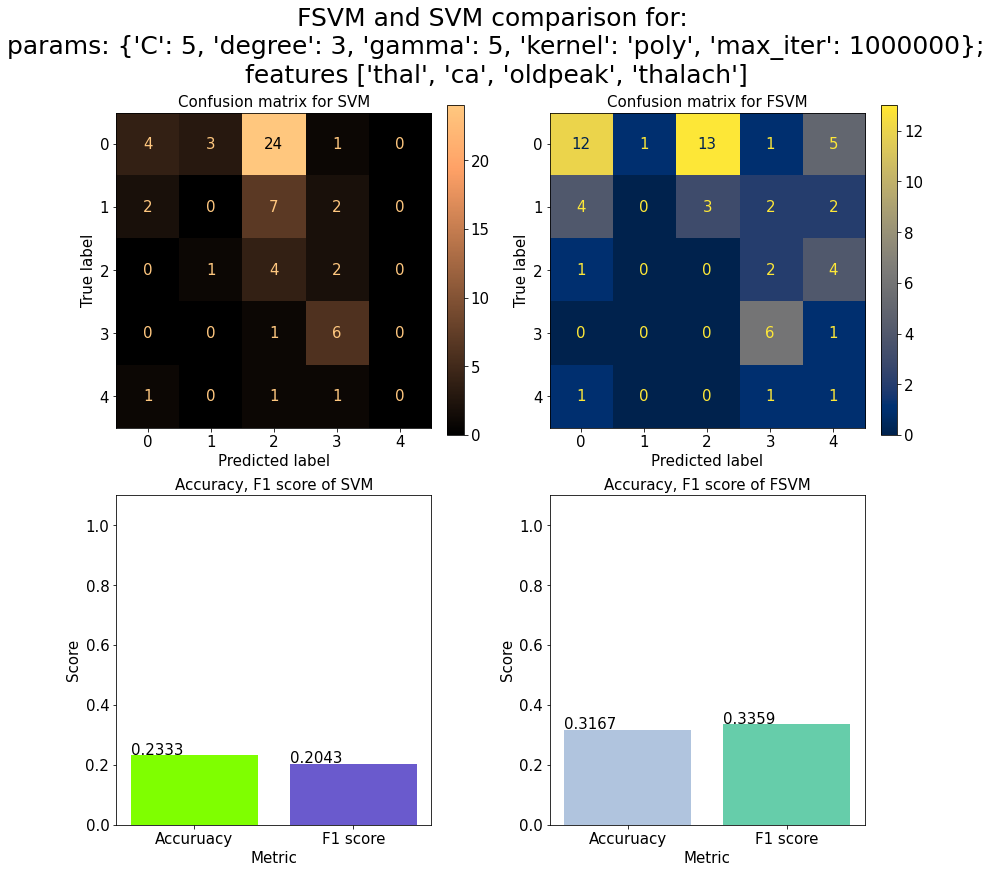

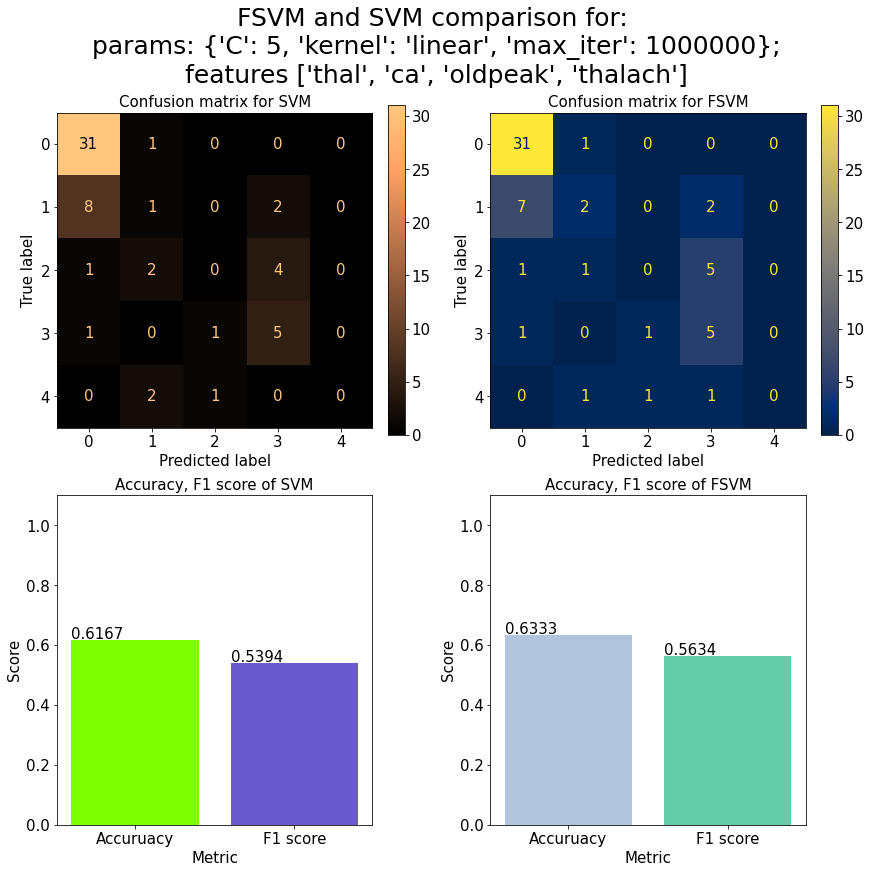

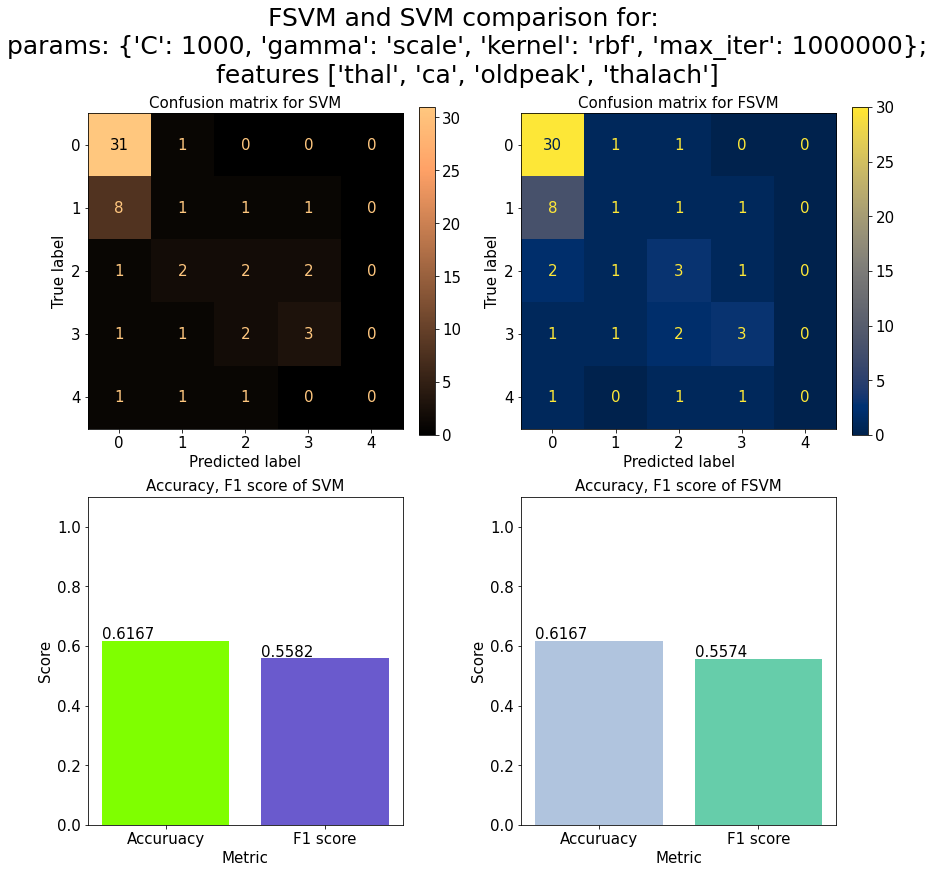

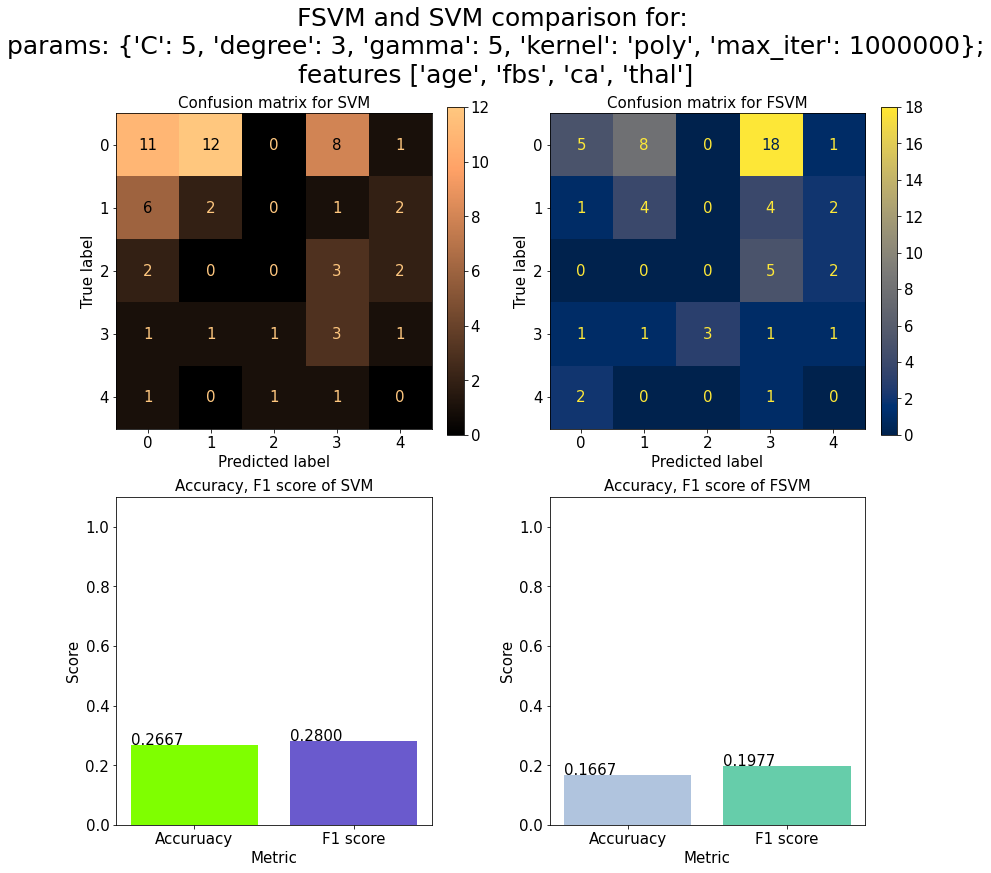

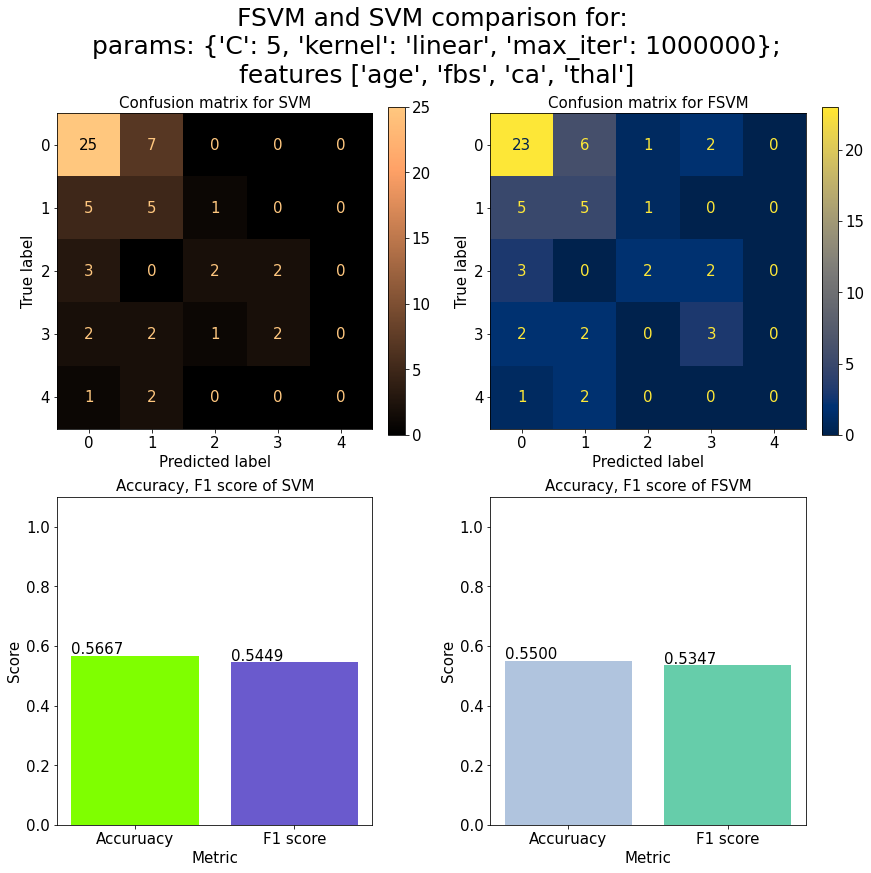

...

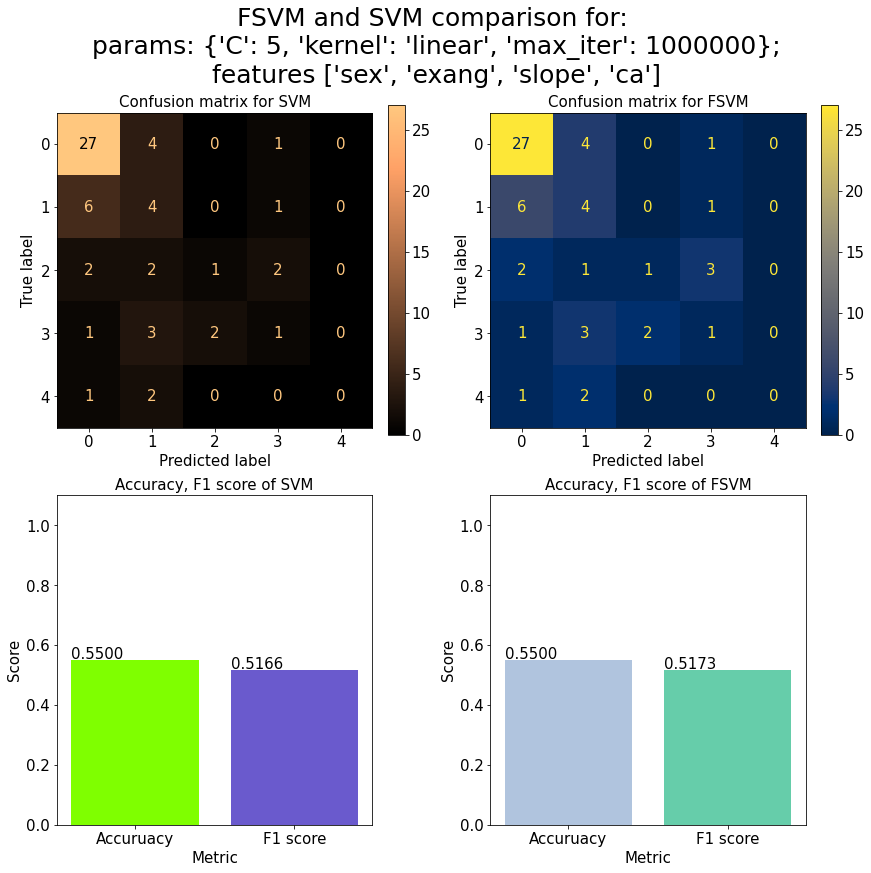

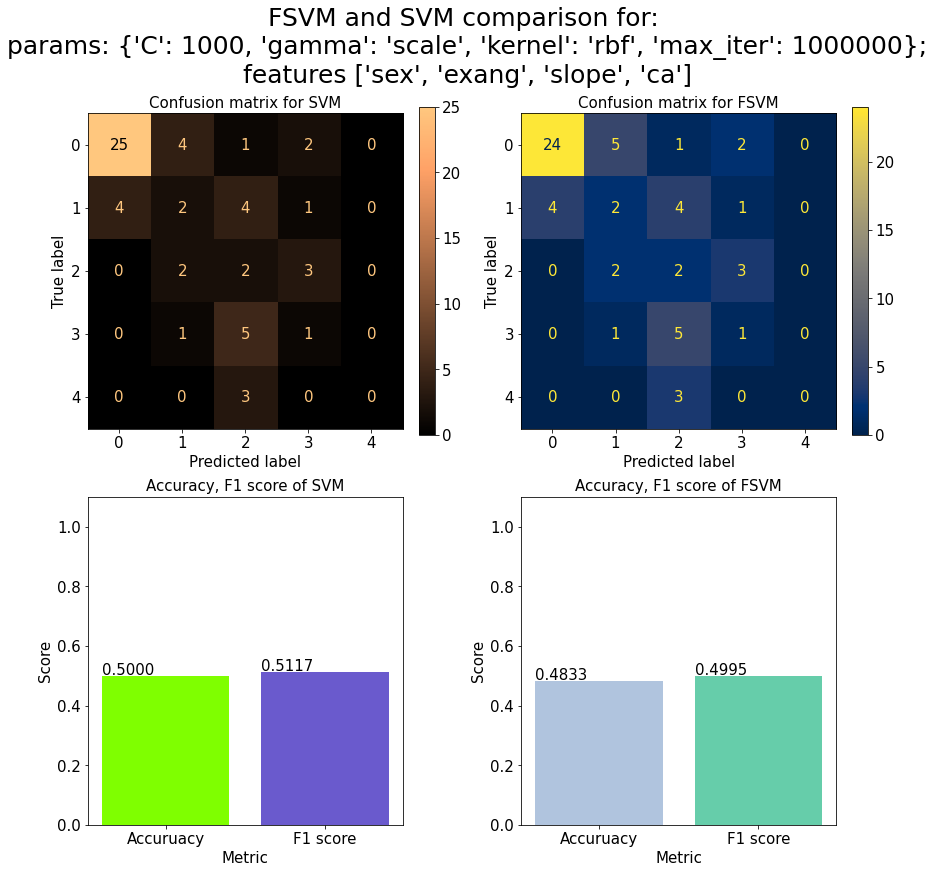

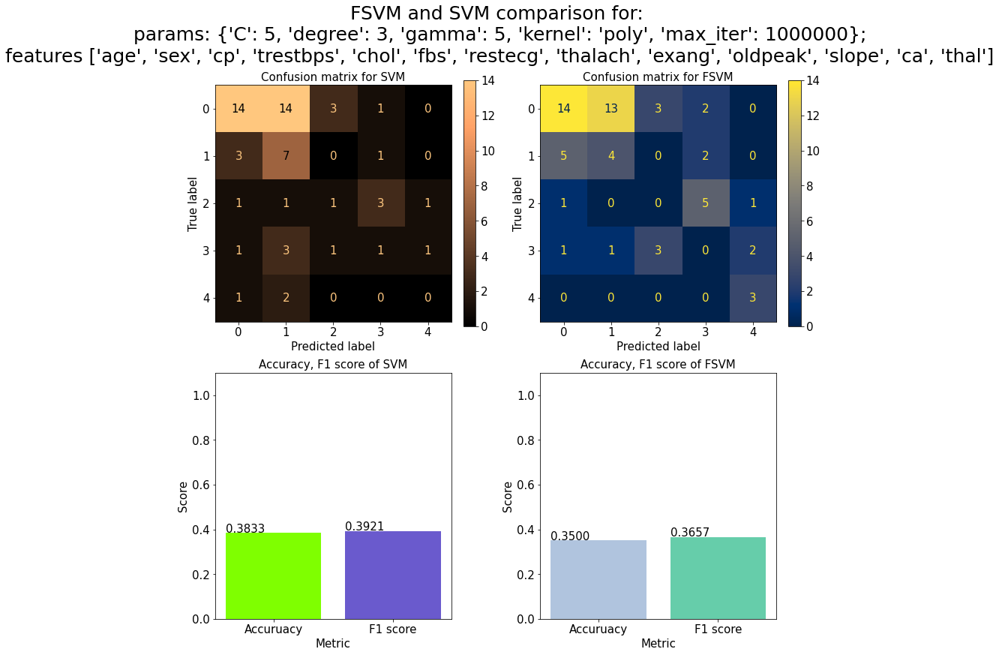

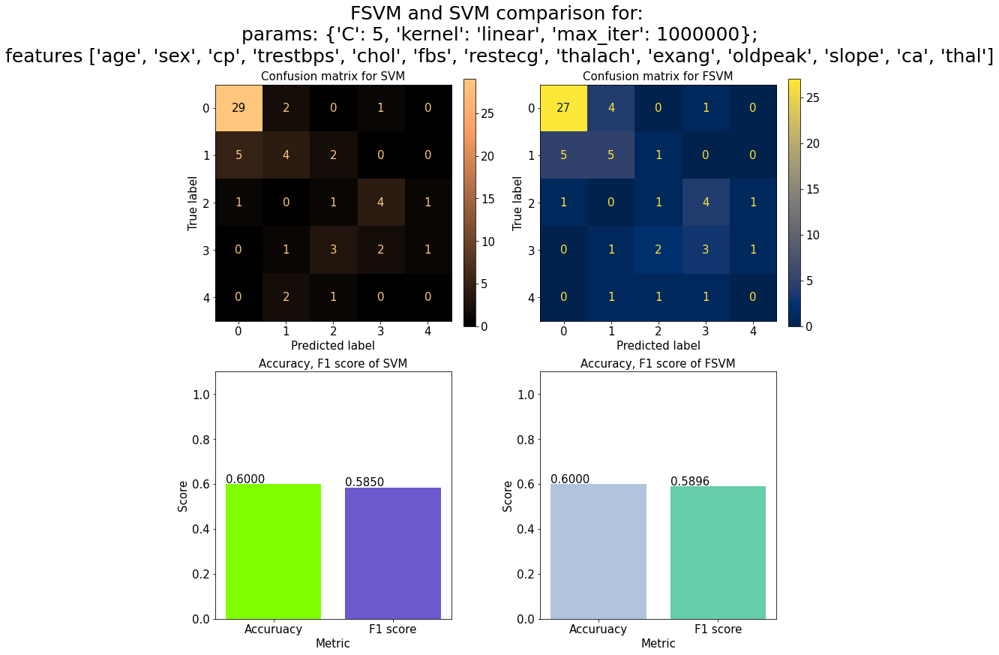

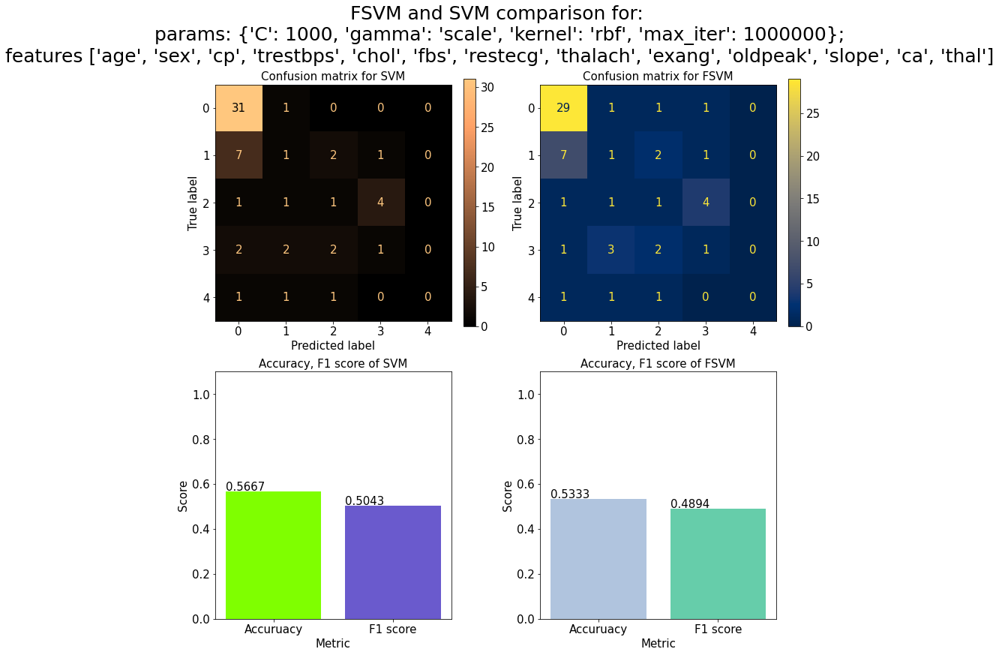

In [97]:
with ignore_warnings(category=ConvergenceWarning):
    for _features in features:
        for params in clf_params:
            fig, axes = plt.subplots(constrained_layout=True, nrows=2, ncols=2, figsize=(12,12))
            
            filtered_train_X = heart_df[_features].copy()
            filtered_test_X = test[_features].copy()
            test_Y = test[class_label].copy()
            train_Y = heart_df[class_label].copy()

            plt.rcParams.update({'font.size': 15})
            svm = SVC(**params)
            fsvm = FSVM(**params)
            fig.suptitle(f"FSVM and SVM comparison for: \nparams: {params};\nfeatures {_features}", fontsize=25)

            svm.fit(filtered_train_X, train_Y)      
            fsvm.fit(filtered_train_X.to_numpy(copy=True), train_Y.to_numpy(copy=True))      

            svm_pred = svm.predict(filtered_test_X)
            fsvm_pred = fsvm.predict(filtered_test_X.to_numpy())

            s_conf_mat = confusion_matrix(test_Y, svm_pred, labels=[0,1,2,3,4])
            s_figure = ConfusionMatrixDisplay(s_conf_mat, display_labels=[0,1,2,3,4])
            s_figure.plot(ax=axes[0, 0], cmap=plt.get_cmap('copper'))
            axes[0, 0].set_title(f"Confusion matrix for SVM", fontsize=15)

            f_conf_mat = confusion_matrix(test_Y.to_numpy(), fsvm_pred, labels=[0,1,2,3,4])
            f_figure = ConfusionMatrixDisplay(f_conf_mat, display_labels=[0,1,2,3,4])
            f_figure.plot(ax=axes[0, 1], cmap=plt.get_cmap('cividis'))
            axes[0, 1].set_title(f"Confusion matrix for FSVM", fontsize=15)

            s_acc, s_f1 = (accuracy_score(test_Y, svm_pred), 
                                f1_score(test_Y, svm_pred, average="weighted"))
            f_acc, f_f1 = (accuracy_score(test_Y.to_numpy(), fsvm_pred), 
                                f1_score(test_Y.to_numpy(), fsvm_pred, average="weighted"))

            rects_f = axes[1, 0].bar(np.arange(0, 2, 1), [s_acc, s_f1],  tick_label= ['Accuruacy', 'F1 score'], 
                                color=["chartreuse", "slateblue"])
            axes[1, 0].set_title("Accuracy, F1 score of SVM", fontsize=15)
            axes[1, 0].set_xlabel("Metric")
            axes[1, 0].set_ylabel("Score")
            axes[1, 0].set_ylim(0, 1.1)

            rects_s = axes[1, 1].bar(np.arange(0, 2, 1), [f_acc, f_f1], tick_label=['Accuruacy', 'F1 score'], 
                                color=["lightsteelblue", "mediumaquamarine"])
            axes[1, 1].set_title("Accuracy, F1 score of FSVM", fontsize=15)
            axes[1, 1].set_xlabel("Metric")
            axes[1, 1].set_ylabel("Score")
            axes[1, 1].set_ylim(0, 1.1)
            for ax in axes[1]:
                for p in ax.patches:
                    ax.annotate(f"{p.get_height():.4f}", (p.get_x(), p.get_height()*1.01), fontsize=15)

            plt.show()

#### Conclusions
- for Heart-disease dataset FSVM is able, in some cases, to outperform classic SVM, however Heart-disease database is quite small, so it was hard to fit classifiers properly.